<a href="https://colab.research.google.com/github/taskswithcode/GRiT/blob/master/TWCGRiT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Notebook to reproduce results of GRiT - a single model for object detection and dense captioning of images**

## 1. Check GPU is available

In [1]:
!nvidia-smi

NVIDIA-SMI has failed because it couldn't communicate with the NVIDIA driver. Make sure that the latest NVIDIA driver is installed and running.



**This demo will work even if GPU is not available - the default setting below assumes only CPU**

In [ ]:
!pip install torch torchvision torchaudio

In [ ]:
!git clone https://github.com/facebookresearch/detectron2.git

In [4]:
cd detectron2

/content/detectron2


In [ ]:
!git checkout cc87e7ec

In [ ]:
!pip install -e .

In [2]:
!pip freeze | grep detectron

-e git+https://github.com/facebookresearch/detectron2.git@cc87e7ec225b5c0449f47794c03335565ec1120e#egg=detectron2


## 2. Download the tar file containing original repository, environment snapshot, and required models

In [ ]:
!git clone https://github.com/taskswithcode/GRiT.git

In [ ]:
cd GRiT

/content/GRiT


In [6]:
cd GRiT

/content/GRiT


In [ ]:
!pip install -r requirements.txt

In [9]:
!mkdir models && cd models

In [ ]:
!wget https://datarelease.blob.core.windows.net/grit/models/grit_b_densecap_objectdet.pth && cd ..

In [ ]:
!ls -l models

In [27]:
from matplotlib.pyplot import imshow
import numpy as np
from PIL import Image
from IPython.display import display # to display imag

## 5a. Run sample tests within the environment, starting with replicating tests from original repository. If you get a GPU, then remove --cpu below for faster inference

In [ ]:
!python demo.py --test-task DenseCap --config-file configs/GRiT_B_DenseCap_ObjectDet.yaml --cpu --input twc_samples/ --output visualization --opts MODEL.WEIGHTS models/grit_b_densecap_objectdet.pth

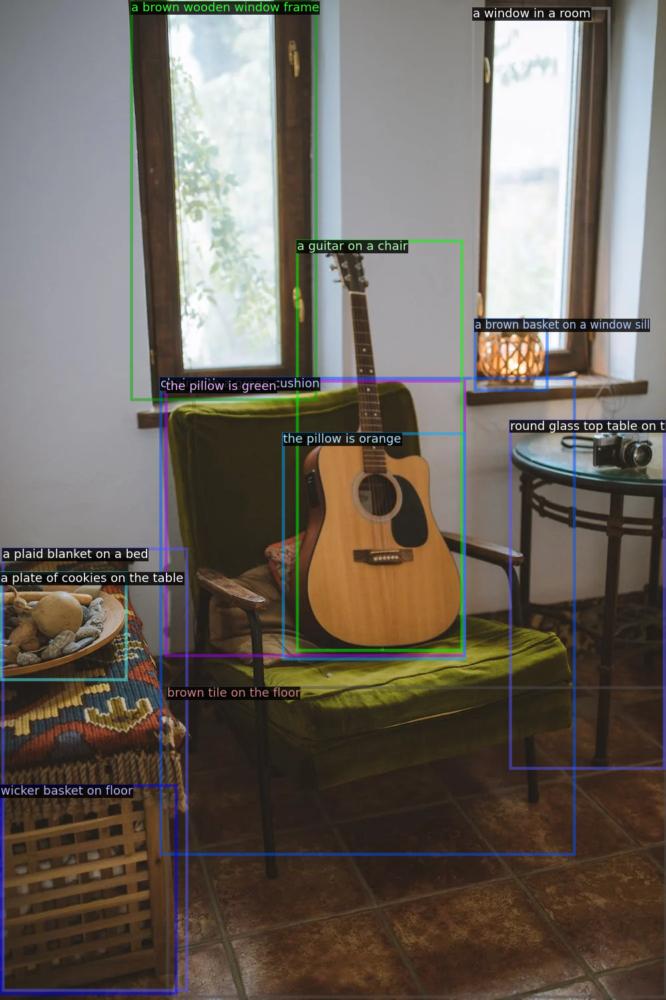

In [28]:
pil_im = Image.open('visualization/guitar.png') #All images are from pexels.com which has a permissible license to use pictures royalty free
display(pil_im)

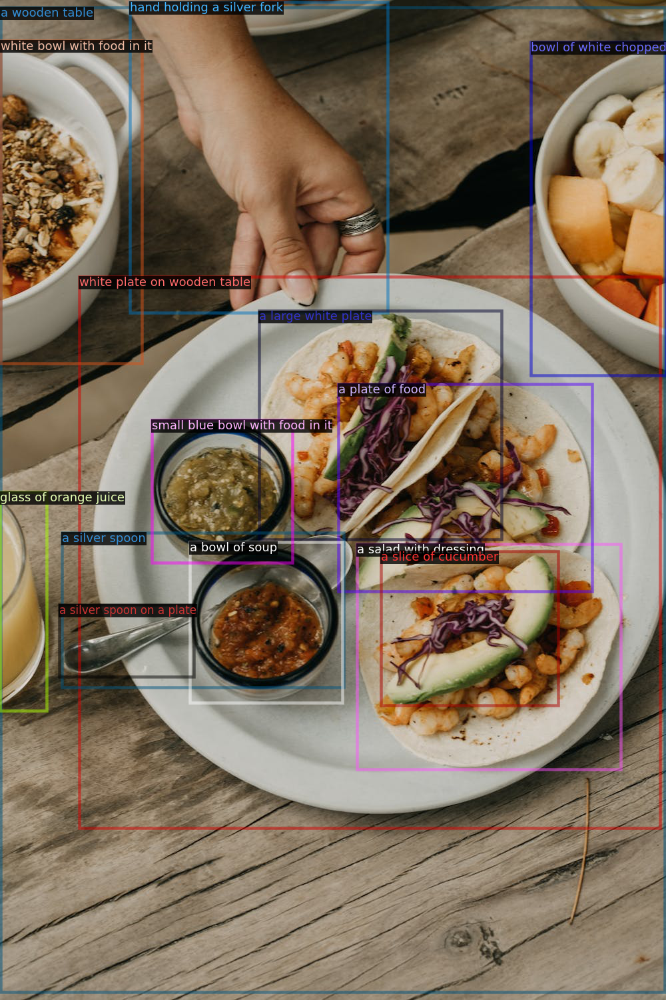

In [29]:
pil_im = Image.open('visualization/tacos.png') #All images are from pexels.com which has a permissible license to use pictures royalty free
display(pil_im)

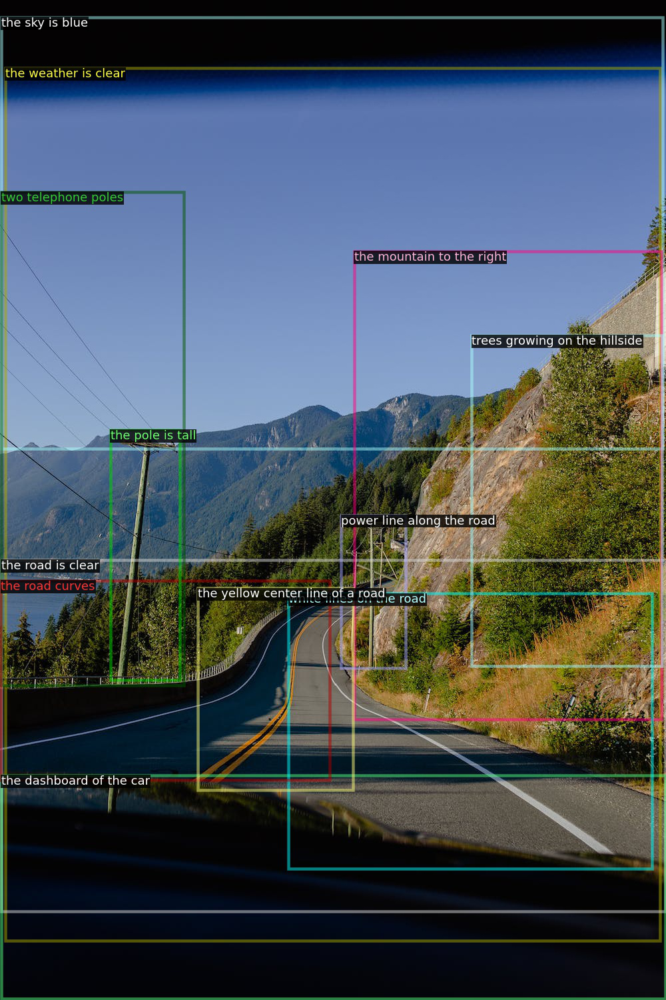

In [32]:
pil_im = Image.open('visualization/mountains.jpeg') #All images are from pexels.com which has a permissible license to use pictures royalty free
display(pil_im)

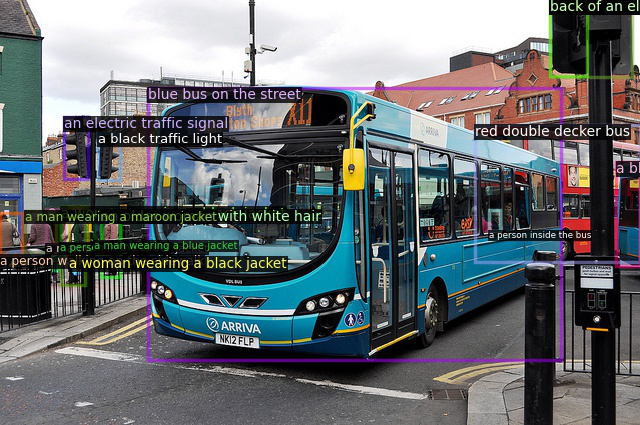

In [34]:
pil_im = Image.open('visualization/bus_ovd.jpg') #Image from COCO dataset. http://images.cocodataset.org/val2017/000000133819.jpg
display(pil_im)

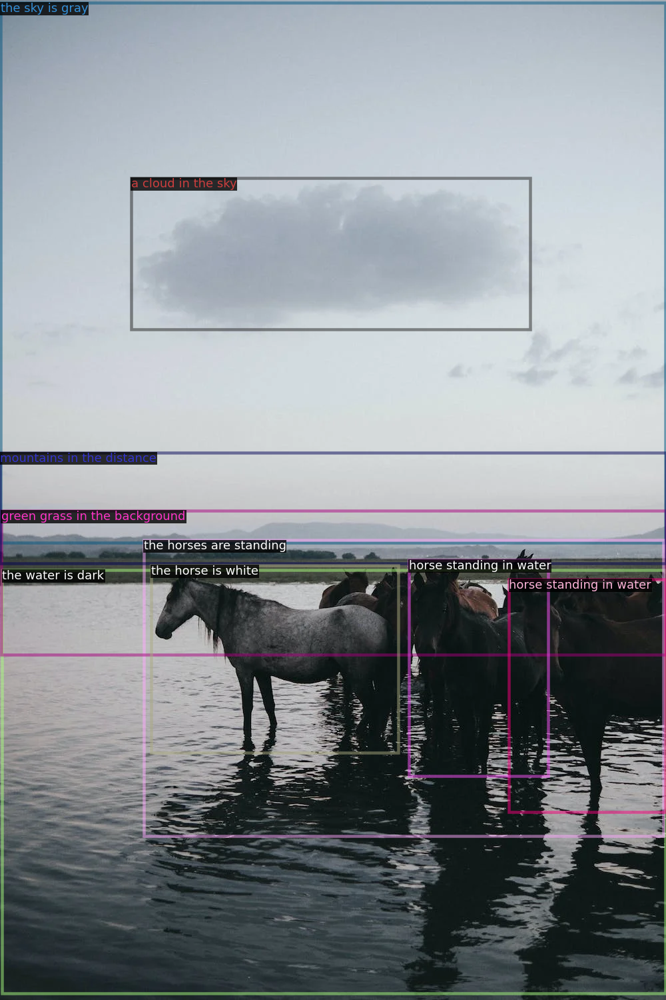

In [36]:
pil_im = Image.open('visualization/horses.png')
display(pil_im)

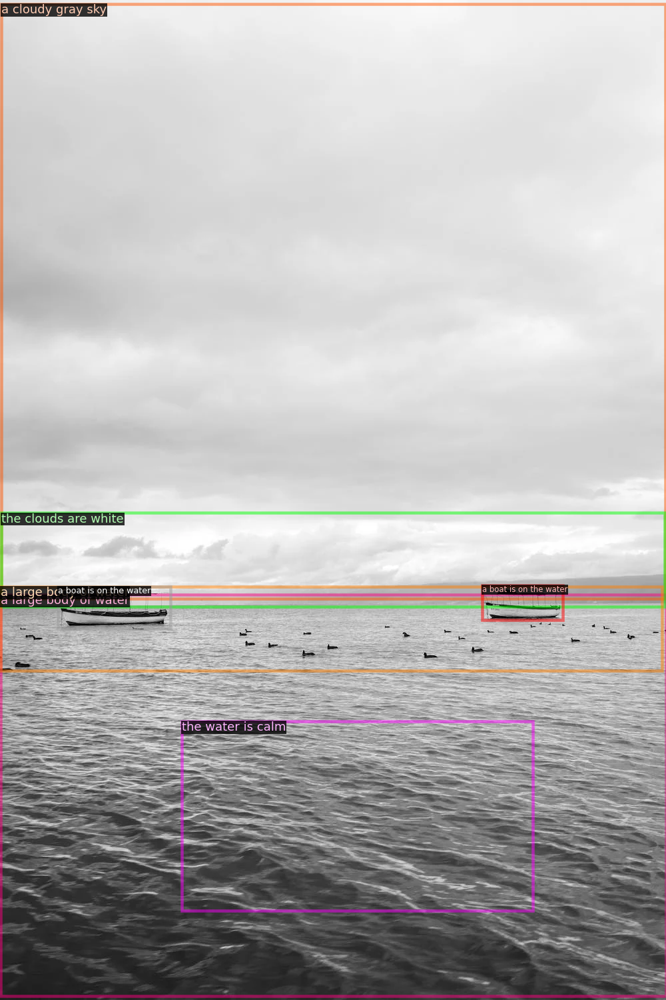

In [37]:
pil_im = Image.open('visualization/boat.png')
display(pil_im)

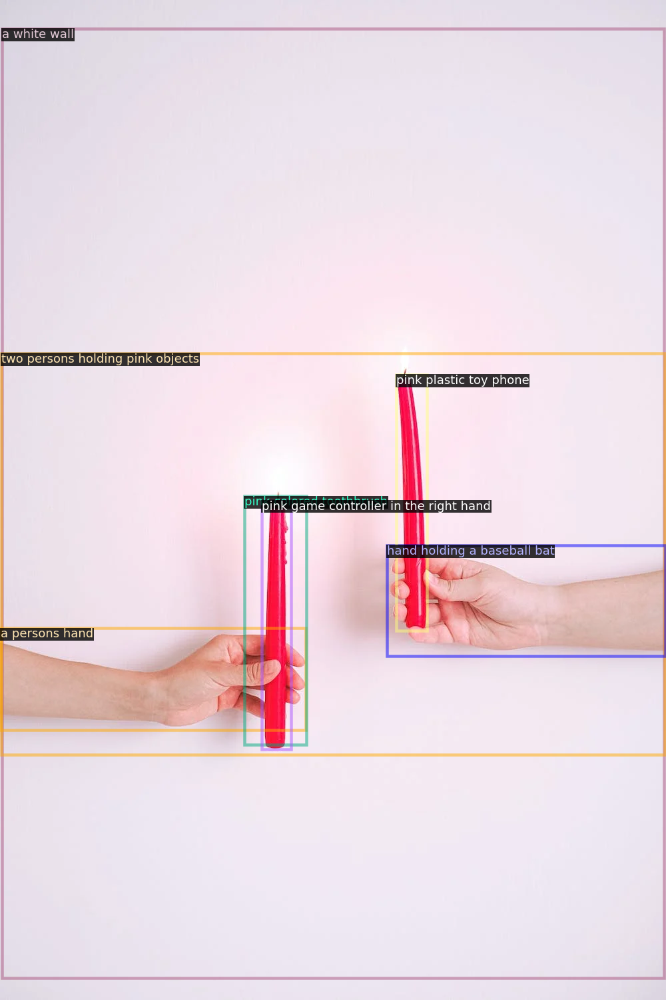

In [38]:
pil_im = Image.open('visualization/candles.png')
display(pil_im)

fileTest custom video upload

In [62]:
!mkdir custom

In [ ]:
from google.colab import files
import os
import shutil

filename = list(files.upload().keys())[0]; print(filename);
os.environ['FILENAME'] = filename
shutil.move(filename,"custom")

Replace input with upload file name. Note SOD on video could take tens of minutes or even hours

**Dense captioning test on custom uploaded files**

In [ ]:
!python demo.py --test-task DenseCap --config-file configs/GRiT_B_DenseCap_ObjectDet.yaml --cpu --input custom/ --output custom_dense --opts MODEL.WEIGHTS models/grit_b_densecap_objectdet.pth

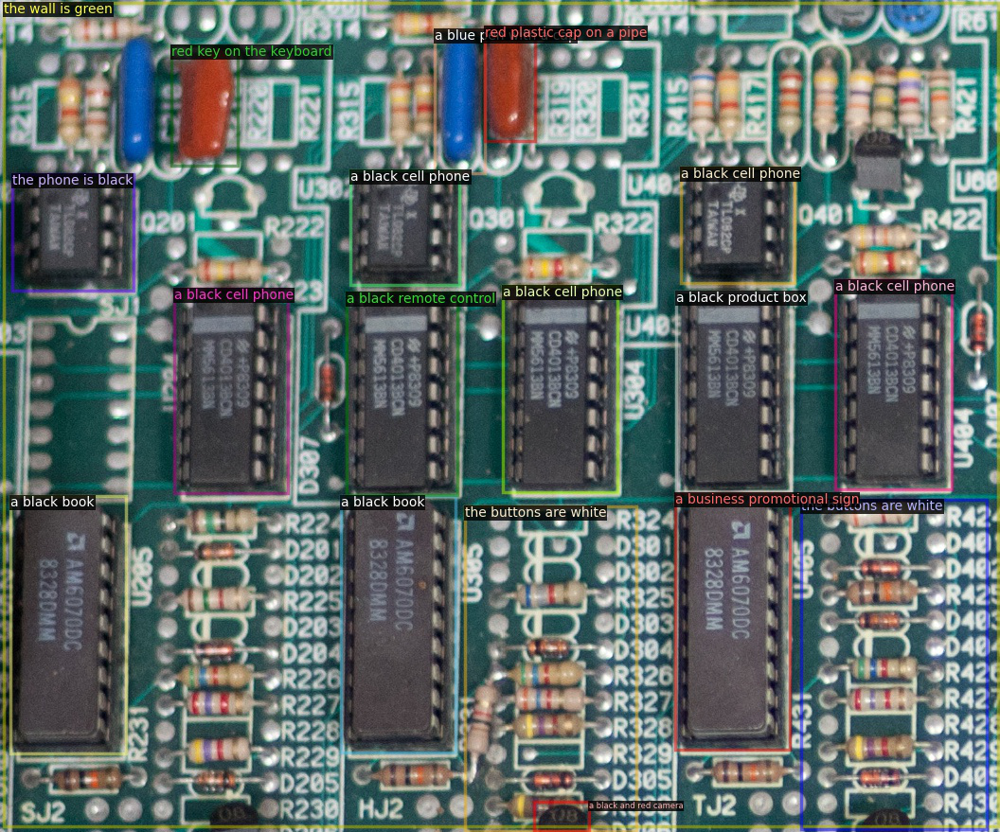

In [69]:
pil_im = Image.open('custom_dense/owlvit1.jpg' + filename)
display(pil_im)

**Object detection only only - no captioning**

In [ ]:
!python demo.py --test-task ObjectDet --config-file configs/GRiT_B_DenseCap_ObjectDet.yaml --cpu --input custom --output visualization2 --opts MODEL.WEIGHTS models/grit_b_densecap_objectdet.pth

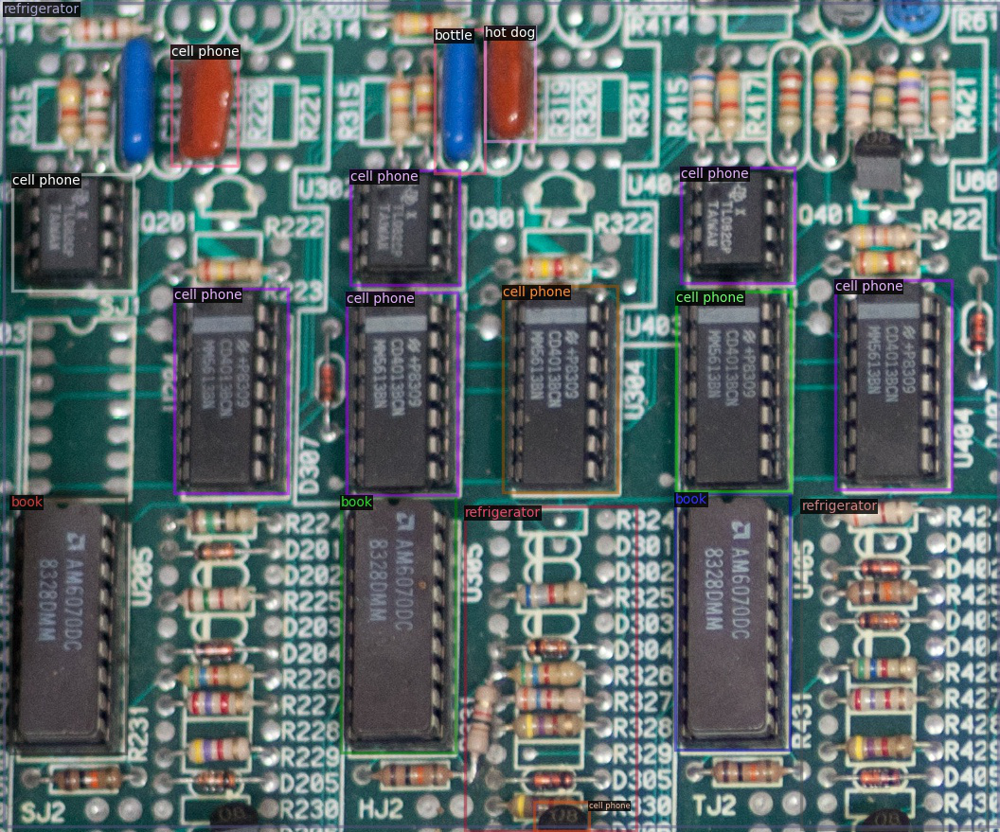

In [77]:
pil_im = Image.open('visualization2/owlvit1.jpg')
display(pil_im)

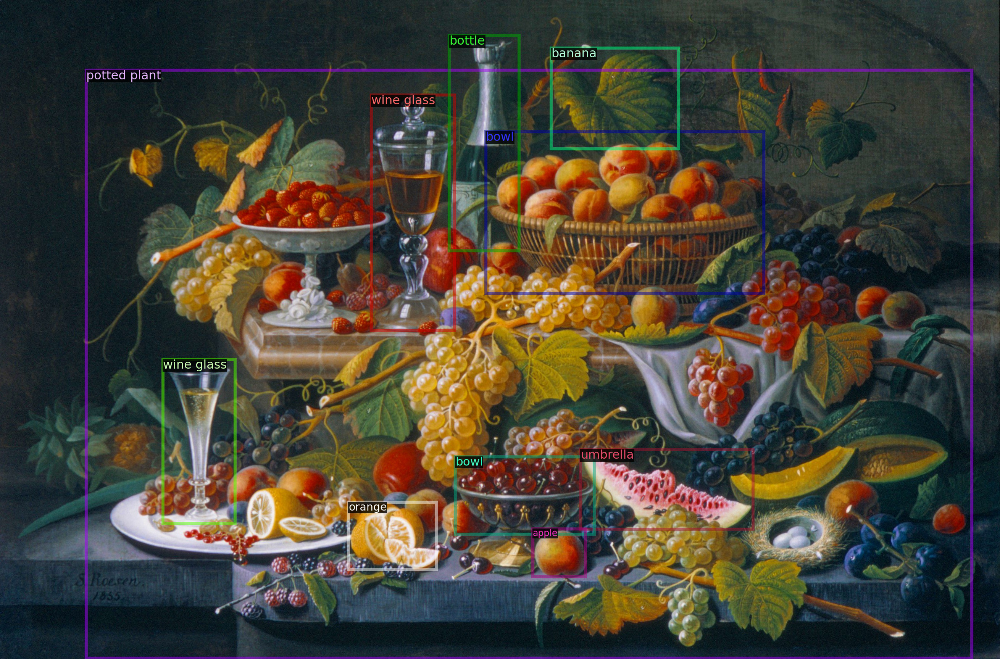

In [78]:
pil_im = Image.open('visualization2/owlvit2.jpg')
display(pil_im)